# Here we are going to apply Linear regression with Python and for this we use Data set of USA House Pricing Data set.

In [33]:
import pyforest

In [34]:
lazy_imports()

['import glob',
 'from sklearn.ensemble import RandomForestClassifier',
 'import plotly as py',
 'import sys',
 'from sklearn.ensemble import RandomForestRegressor',
 'import seaborn as sns',
 'import gensim',
 'from dask import dataframe as dd',
 'import dash',
 'import awswrangler as wr',
 'import tensorflow as tf',
 'import tqdm',
 'from sklearn import svm',
 'from sklearn.feature_extraction.text import TfidfVectorizer',
 'import xgboost as xgb',
 'from sklearn.model_selection import train_test_split',
 'from sklearn.ensemble import GradientBoostingRegressor',
 'from pyspark import SparkContext',
 'from sklearn.ensemble import GradientBoostingClassifier',
 'import datetime as dt',
 'from openpyxl import load_workbook',
 'import matplotlib as mpl',
 'from sklearn.manifold import TSNE',
 'import numpy as np',
 'import sklearn',
 'import lightgbm as lgb',
 'from pathlib import Path',
 'import statistics',
 'import re',
 'import altair as alt',
 'import os',
 'import matplotlib.pyplot a

## Here we are using Pyforset with the help of Pyforest we don't have to import this upper library they are inside Pyforest

## 1. So first step is Load Data

In [35]:
usa_housing_data_path = ("/home/nikhil/Desktop/Excel_Data/USA_Housing.csv") 

usa_df = pd.read_csv(usa_housing_data_path)
usa_df.head()
# here prie is in milion dollar

<IPython.core.display.Javascript object>

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price,Address
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06,"208 Michael Ferry Apt. 674\nLaurabury, NE 3701..."
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06,"188 Johnson Views Suite 079\nLake Kathleen, CA..."
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06,"9127 Elizabeth Stravenue\nDanieltown, WI 06482..."
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06,USS Barnett\nFPO AP 44820
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05,USNS Raymond\nFPO AE 09386


In [36]:
usa_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 7 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Avg. Area Income              5000 non-null   float64
 1   Avg. Area House Age           5000 non-null   float64
 2   Avg. Area Number of Rooms     5000 non-null   float64
 3   Avg. Area Number of Bedrooms  5000 non-null   float64
 4   Area Population               5000 non-null   float64
 5   Price                         5000 non-null   float64
 6   Address                       5000 non-null   object 
dtypes: float64(6), object(1)
memory usage: 273.6+ KB


In [37]:
# here address column is not available because describe not explain string
usa_df.describe()

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price
count,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5.000000e+03
mean,68583.108984,5.977222,6.987792,3.981330,36163.516039,1.232073e+06
std,10657.991214,0.991456,1.005833,1.234137,9925.650114,3.531176e+05
min,17796.631190,2.644304,3.236194,2.000000,172.610686,1.593866e+04
25%,61480.562388,5.322283,6.299250,3.140000,29403.928702,9.975771e+05
50%,68804.286404,5.970429,7.002902,4.050000,36199.406689,1.232669e+06
75%,75783.338666,6.650808,7.665871,4.490000,42861.290769,1.471210e+06
max,107701.748378,9.519088,10.759588,6.500000,69621.713378,2.469066e+06


In [38]:
# for check the columns
usa_df.columns

Index(['Avg. Area Income', 'Avg. Area House Age', 'Avg. Area Number of Rooms',
       'Avg. Area Number of Bedrooms', 'Area Population', 'Price', 'Address'],
      dtype='object')

## 2. So the data is loaded and we briefly get the information about data now Move toward Data visualization

## Data visualization with seaborn 

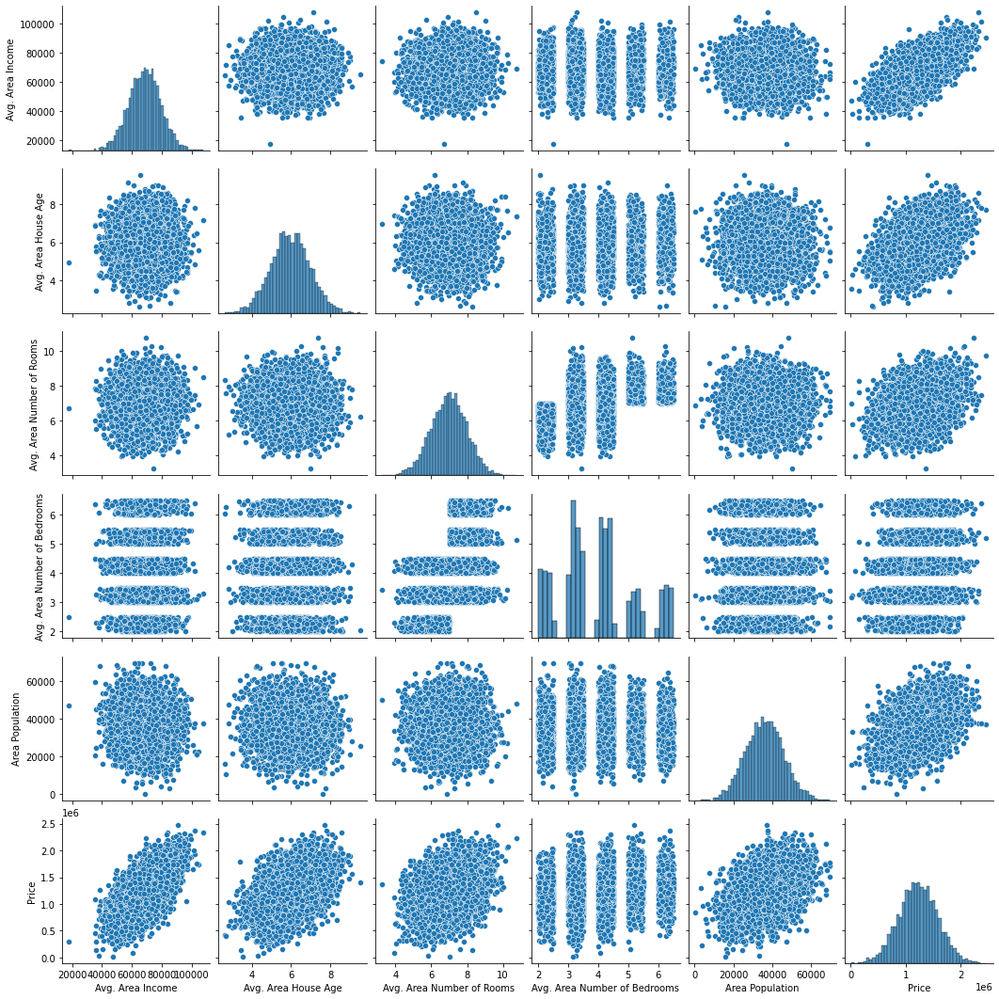

In [39]:
# pair plot - it will not only create Histogram as well as scatter plot
import seaborn as sns
sns.pairplot(usa_df)

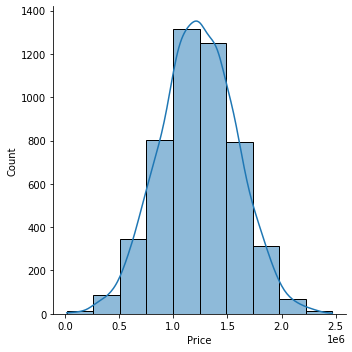

In [42]:
sns.displot(usa_df['Price'], kde = True, bins = 10)
# here we can say data follow Normal Distribution

In [44]:
corelation = usa_df.corr()
corelation

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price
Avg. Area Income,1.000000,-0.002007,-0.011032,0.019788,-0.016234,0.639734
Avg. Area House Age,-0.002007,1.000000,-0.009428,0.006149,-0.018743,0.452543
Avg. Area Number of Rooms,-0.011032,-0.009428,1.000000,0.462695,0.002040,0.335664
Avg. Area Number of Bedrooms,0.019788,0.006149,0.462695,1.000000,-0.022168,0.171071
Area Population,-0.016234,-0.018743,0.002040,-0.022168,1.000000,0.408556
Price,0.639734,0.452543,0.335664,0.171071,0.408556,1.000000


<AxesSubplot:>

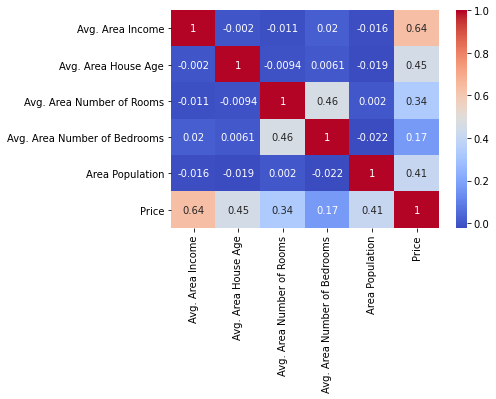

In [46]:
sns.heatmap(corelation,cmap='coolwarm',annot=True)

## Data Visualization with Plotly

In [51]:
from plotly import __version__
import cufflinks as cf
import plotly.graph_objs as go
from  plotly.offline import plot
import chart_studio.plotly as py
import cufflinks as cf
cf.go_offline()
from plotly.offline import download_plotlyjs, init_notebook_mode, plot,iplot
'''plotly is an opensource lib to use and to start with plotly we have to connect plotly offline to to our working notebook'''
from plotly.offline import download_plotlyjs, init_notebook_mode,plot,iplot
# to connect plotly to notebook and use features of javascript for data visualize
init_notebook_mode(connected=True)

In [53]:
#usa_df.iplot()

In [54]:
usa_df.scatter_matrix()